# How much is this car worth?

**Goal**: Providing guideline for determining the starting negotiation price of used cars when posting and search in Craigslist

In [1]:
import pandas as pd
import numpy as np

import re
import matplotlib.pyplot as plt
import plotly_express as px
#import cufflinks as cf
from IPython.display import IFrame

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import (GradientBoostingRegressor, RandomForestRegressor)
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from pprint import pprint


import eli5
from eli5.sklearn import PermutationImportance
import warnings
warnings.filterwarnings("ignore")

#cf.set_config_file(offline=True)

#import plotly.offline as py
#py.init_notebook_mode(connected=False)
#pd.set_option('display.max_columns', 800)
#pd.set_option('display.expand_frame_repr', False)
#pd.set_option('max_colwidth', -1)

In [2]:
def pre_clean_df(raw_df):
    df=raw_df[['url', 'city', 'price', 'year', 'company', 'model', 'condition',
       'cylinders', 'fuel', 'mileage', 'title_status', 'transmission', 'drive',
       'size', 'type', 'paint_color']]
    
    df.dropna(subset=['company'], inplace=True)
    df.dropna(subset=['mileage'], inplace=True)
    
    brand_lst=['ford', 'chevrolet','toyota','honda','bmw','nissan','mercedes-benz','ram','jeep','gmc','dodge','volkswagen','lexus','hyundai',
    'subaru','audi','acura','kia','mazda','cadillac','chrysler','infiniti','volvo', 'mini', 'buick']
    df=df[df.company.str.contains('|'.join(brand_lst))]
    
    
    df.drop(df.loc[(df.year<1980)].index, axis=0, inplace=True)
    df.drop(df.loc[(df.price>90000)|(df.price<50)].index, axis=0, inplace=True)
    df.drop(df.loc[(df.year>2019)&(df.price<15000)].index, axis=0, inplace=True)
    df.drop(df.loc[(df.mileage>500000)].index, axis=0, inplace=True)
    df.drop(df.loc[(df.mileage<2000)&(df.year<2019)].index, axis=0, inplace=True)
    df.drop(df.loc[(df.company=='bmw')&(df.year<1990)&(df.price>50000)].index, axis=0, inplace=True)
    df.drop(df.loc[(df.mileage>900000)].index, axis=0, inplace=True)   
    
    df.reset_index(drop=True, inplace=True)
    return df

In [3]:
def df_stand(df):
    df['year'] = df['year'].apply(lambda x : (2020-x)/40)
    df['mileage'] = df['mileage'].apply(lambda x : (x-df['mileage'].mean())/df['mileage'].std())
    return df

In [4]:
def make_simple(df,col='model'):
   
    df[col]=df[col].fillna('null')
    df[col]=df[col].str.lower()
    df[col]=df[col].str.replace('-','', regex=True)
    df[col]=df[col].str.replace(' ','', regex=True)
    car_model=['silverado', 'f150', 'civic', 'accord', 'f250', 'camry', 'tacoma', 'corolla', 'wrangler',
              'sierra', 'prius', 'f350', 'altima', 'mustang', 'cherokee', 'x5', 'x3', 'tundra', 'fusion', 'focus',
               'tahoe', 'jetta', 'yukon', 'crv', 'explorer', 'sentra', 'cooper', 'escape', 'sienna', '328i', 'sonata',
               'rav4', 'odyssey', 'elantra', 'outback', 'suburban', 'a4', '4runner', 'camaro', 'cruze', 'e350', 
               'highlander', 'rogue', '3series', 'escalade', 'charger', 'impala', 'ranger', 'pilot', 'malibu',
               'challenger', 'forester', 'impreza', 'expedition', 'genesis','gti','cclass', 'corvette', 'frontier', 'colorado',
                'passat', 'mdx', 'optima', 'versa', 'sprinter', 'equinox', 'is250', 'is350','edge', 'grand caravan', 'eclass',
               'santafe', 'mazda3', 'durango', 'tsx', '5series','7series' 'f550', 'xc90', 'q5','soul', 'cruiser','wrx','golf', 'sorento', 
               'traverse', 'acadia', 'pathfinder', 'beetle', 'xterra', '1500', '2500', '3500']
    for i in car_model:
        df[col][df[col].str.contains(i)]=i
    df[col][df[col].apply(lambda x: x not in car_model)]='null'
    df['cylinders']=df['cylinders'].str.replace(' ','_', regex=True)
    df.drop(columns=['city','company', 'url'], inplace=True)
    return df

In [5]:
def get_dummy(df):
    dummy_col=df.select_dtypes('object').columns
    new_df=pd.get_dummies(df, columns=dummy_col, dummy_na=True,prefix=dummy_col)
    return new_df

In [6]:
def X_y_split(df):
    y=df.pop('price')
    X=df
    return X,y

In [7]:
def tt_split(X, y, test_size=.2):
    X_train, X_test, y_train, y_test=train_test_split(X,y, test_size=test_size)
    return X_train, X_test, y_train, y_test

In [8]:
def df_ready(df):
    df1=pre_clean_df(df)
    X, y = X_y_split(df1)
    X_train1, X_test1, y_train, y_test= tt_split(X, y)
    
    X_train2=make_simple(X_train1)
    X_train3=get_dummy(X_train2)
    X_train=df_stand(X_train3)
    
    
    X_test2=make_simple(X_test1)
    X_test3=get_dummy(X_test2)
    X_test=df_stand(X_test3)
    
    return X_train, X_test, y_train, y_test

In [9]:
def clean_and_test(df):
    df=pre_clean_df(df)
    X, y = X_y_split(df)
    X=make_simple(X)
    X=get_dummy(X)
    X=df_stand(X)
    return X, y

In [10]:
def evaluation(model, X,y):
    y_pred=model.predict(X)
    y_base=np.ones(len(y))*y.median()
    rmse_model=np.sqrt(mean_squared_error(y,y_pred))
    rmse_base=np.sqrt(mean_squared_error(y,y_base))
    
    print('RMSE of model : {:2.2f}'.format(np.sqrt(mean_squared_error(y,y_pred))))
    print('R2 of model : {:2.2f}'.format(r2_score(y, y_pred)))
    print('Base RMSE: {}'.format(rmse_base))
    print('Error reduction (RMSE of predict/RMSE of base) : {:2.2f}'.format(rmse_model/rmse_base))
    return rmse_model

# Data acquisition

Data is obtained from the web scrapping of California craigslist site from June 21, 2019 to June 27, 2019 (7 Days).

In [13]:
raw_df=pd.read_csv('data/car_data_final.csv')

In [12]:
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 237347 entries, 0 to 237346
Data columns (total 16 columns):
url             237347 non-null object
city            237347 non-null object
price           237347 non-null int64
year            236994 non-null float64
company         223550 non-null object
model           231221 non-null object
condition       130062 non-null object
cylinders       139521 non-null object
fuel            236520 non-null object
mileage         191022 non-null float64
title_status    236114 non-null object
transmission    235256 non-null object
drive           164950 non-null object
size            77199 non-null object
type            176577 non-null object
paint_color     161160 non-null object
dtypes: float64(2), int64(1), object(13)
memory usage: 29.0+ MB


In [13]:
df=pre_clean_df(raw_df)

In [14]:
px.scatter(df, x='year', y='price', title='Year Made vs Car price', color='company', template='plotly_dark')fig.update_traces(mode='markers', marker_line_width=2, marker_size=10)

In [15]:
px.scatter(df, x='year', y='mileage',title='Year Made vs Mileage', color='company', template='plotly_dark')

In [16]:
#px.histogram(df, x='city', title='Number of data', template='plotly_dark')

In [17]:
#px.box(df, x='city', y='price', title='Car Price vs City', notched=True, template='plotly')

In [18]:
#px.histogram(df, x='price',nbins=150, title='Car Price', template='plotly_dark')

In [19]:
#px.histogram(df, x='company',title='Number of Cars per Company', template='plotly_dark').update_xaxes(categoryorder='total descending')

# OneHotEncoding and Train-Test-Split

In [12]:
X_train, X_test, y_train, y_test=df_ready(raw_df)

NameError: name 'raw_df' is not defined

In [21]:
# print("----------------HEAD----------------\n")
# print(df.model.value_counts().head(10))
# print("\n----------------TAIL---------------\n")
# print(df.model.value_counts().tail(20))

# Decision Tree from Random Forest

In [11]:
rfr=RandomForestRegressor(max_depth=10, n_estimators=1000)
rfr.fit(X_train, y_train)

NameError: name 'X_train' is not defined

In [23]:
y_pred_rfr=rfr.predict(X_test)

In [24]:
#np.sqrt(mean_squared_error(y_test, y_pred_rfr))

In [25]:
rfr_fit = rfr.fit(X_train, y_train)
perm = PermutationImportance(rfr_fit).fit(X_test, y_test)
eli5.show_weights(perm)

Weight,Feature
0.4833 ± 0.0120,x0
0.2695 ± 0.0088,x1
0.1286 ± 0.0048,x128
0.1108 ± 0.0015,x110
0.0796 ± 0.0039,x107
0.0633 ± 0.0051,x127
0.0501 ± 0.0032,x104
0.0198 ± 0.0018,x106
0.0187 ± 0.0008,x136
0.0183 ± 0.0031,x130


In [26]:
DTFI=pd.DataFrame({'feature': X_test.columns.values})
DTFI['weight']=perm.feature_importances_
DTFI.sort_values(by='weight', ascending=False, inplace=True)

In [27]:
#DTFI.to_csv('Permutation_importance.csv', header=True)

In [28]:
DTFI.head(15)

,feature,weight
0,year,0.483285
1,mileage,0.269471
128,drive_fwd,0.128636
110,fuel_diesel,0.110789
107,cylinders_8_cylinders,0.079644
127,drive_4wd,0.063332
104,cylinders_4_cylinders,0.050084
106,cylinders_6_cylinders,0.019817
136,type_SUV,0.018733
130,drive_nan,0.018299


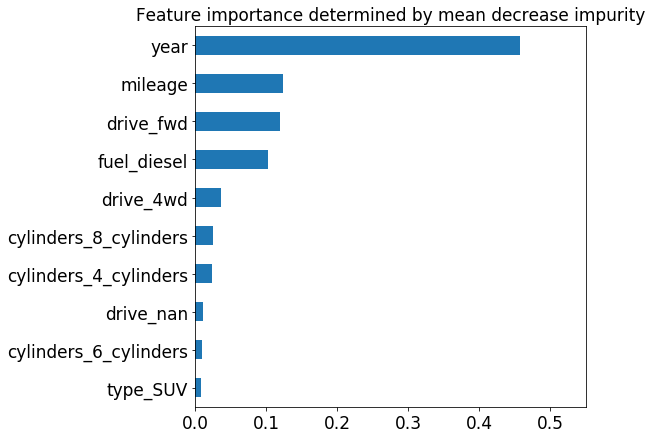

In [29]:
feat_scores = pd.DataFrame({'Fraction of Samples Affected' : rfr.feature_importances_},
                           index=X_train.columns)
feat_scores = feat_scores.sort_values(by='Fraction of Samples Affected')
ax=feat_scores.plot(kind='barh', figsize=(7,7), fontsize=17, legend=False)
ax.set_xlim(0,.55)
ax.set_ylim(152.5,162.5);
ax.set_title('Feature importance determined by mean decrease impurity', fontsize=17)
plt.savefig('img/MDI.png', bbox_inches='tight')

In [30]:
px.scatter_3d(df, x='year', y='mileage', z='price', title= 'Year vs Mileage vs Price', color='company', hover_name='price',template='plotly_white', opacity=.5)

# Model Selection

In [16]:
imp_feat=['year', 'mileage', 'drive_fwd', 'fuel_diesel',
       'cylinders_8_cylinders', 'drive_4wd', 'cylinders_4_cylinders',
       'cylinders_6_cylinders', 'type_SUV', 'drive_nan', 'type_sedan',
       'type_pickup']

In [17]:
X_train_if=X_train[imp_feat]
X_test_if=X_test[imp_feat]

In [33]:
gb=GradientBoostingRegressor()
gb.fit(X_train_if, y_train)
print('Important Features Only')
evaluation(gb, X_test_if,y_test)

Important Features Only
RMSE of model : 6260.39
R2 of model : 0.68
Base RMSE: 11309.310270099197
Error reduction (RMSE of predict/RMSE of base) : 0.55


6260.386404882254

In [34]:
gb=GradientBoostingRegressor()
gb.fit(X_train, y_train)
gb_y_pred=gb.predict(X_test)
print('Total Features')
evaluation(gb, X_test,y_test)

Total Features
RMSE of model : 5939.01
R2 of model : 0.71
Base RMSE: 11309.310270099197
Error reduction (RMSE of predict/RMSE of base) : 0.53


5939.0125939315

In [35]:
rf=RandomForestRegressor()
rf.fit(X_train_if, y_train)
print('Important Features Only')
evaluation(rf, X_test_if,y_test)

Important Features Only
RMSE of model : 6133.48
R2 of model : 0.69
Base RMSE: 11309.310270099197
Error reduction (RMSE of predict/RMSE of base) : 0.54


6133.47592926361

In [36]:
rf=RandomForestRegressor()
rf.fit(X_train, y_train)
print('Total Features')
evaluation(rf, X_test,y_test)

Total Features
RMSE of model : 4105.07
R2 of model : 0.86
Base RMSE: 11309.310270099197
Error reduction (RMSE of predict/RMSE of base) : 0.36


4105.074778035924

In [20]:
lr = LinearRegression().fit(X_train[['year', 'mileage']], y_train)
print('Important Features Only')
evaluation(lr, X_test[['year', 'mileage']],y_test)

Important Features Only
RMSE of model : 8982.26
R2 of model : 0.35
Base RMSE: 11458.734056239815
Error reduction (RMSE of predict/RMSE of base) : 0.78


8982.257038267155

In [19]:
lr = LinearRegression().fit(X_train, y_train)
lr_y_pred=lr.predict(X_test)
print('Total Features')
evaluation(lr, X_test,y_test)

Total Features
RMSE of model : 6667.49
R2 of model : 0.64
Base RMSE: 11458.734056239815
Error reduction (RMSE of predict/RMSE of base) : 0.58


6667.487912549897

In [39]:
# rf = RandomForestRegressor(random_state = 42)
# pprint(rf.get_params())

{'bootstrap': True,
 'criterion': 'mse',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 'warn',
 'n_jobs': None,
 'oob_score': False,
 'random_state': 42,
 'verbose': 0,
 'warm_start': False}

In [40]:
# n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# max_features = ['auto', 'sqrt']
# max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
# max_depth.append(None)
# min_samples_split = [2, 5, 10]
# min_samples_leaf = [1, 2, 4]
# bootstrap = [True, False]
# random_grid = {'n_estimators': n_estimators,
#                'max_features': max_features,
#                'max_depth': max_depth,
#                'min_samples_split': min_samples_split,
#                'min_samples_leaf': min_samples_leaf,
#                'bootstrap': bootstrap}
# pprint(random_grid)

{'bootstrap': [True, False],
 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, None],
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2, 4],
 'min_samples_split': [2, 5, 10],
 'n_estimators': [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000]}

In [41]:
# rf = RandomForestRegressor()
# rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 30, cv = 3, verbose=2, random_state=42, n_jobs = -1)
# rf_random.fit(X_train, y_train)

Fitting 3 folds for each of 30 candidates, totalling 90 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed: 106.2min
[Parallel(n_jobs=-1)]: Done  90 out of  90 | elapsed: 434.1min finished
RandomizedSearchCV(cv=3, error_score='raise-deprecating',
                   estimator=RandomForestRegressor(bootstrap=True,
                                                   criterion='mse',
                                                   max_depth=None,
                                                   max_features='auto',
                                                   max_leaf_nodes=None,
                                                   min_impurity_decrease=0.0,
                                                   min_impurity_split=None,
                                                   min_samples_leaf=1,
                                                   min_samples_split=2,
                                                   min_weight_fraction_leaf=0.0,
                                                   n_estimators='warn',
                                                   n_jobs=None, oob_score=False,
                                                   random_sta...
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 20, 30, 40, 50, 60,
                                                      70, 80, 90, 100, 110,
                                                      None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [200, 400, 600, 800,
                                                         1000, 1200, 1400, 1600,
                                                         1800, 2000]},
                   pre_dispatch='2*n_jobs', random_state=42, refit=True,
                   return_train_score=False, scoring=None, verbose=2)

In [42]:
#rf_random.best_params_

{'n_estimators': 2000,
 'min_samples_split': 2,
 'min_samples_leaf': 1,
 'max_features': 'sqrt',
 'max_depth': 110,
 'bootstrap': True}

In [35]:
# from sklearn.model_selection import GridSearchCV
# # Create the parameter grid based on the results of random search 
# param_grid = {
#     'bootstrap': [True],
#     'max_depth': [90, 100, 110, 120],
#     'min_samples_split': [2, 3, 4],
#     'n_estimators': [1000, 1500, 2000]
# }
# # Create a based model
# rf = RandomForestRegressor()
# # Instantiate the grid search model
# grid_search = GridSearchCV(estimator = rf, param_grid = param_grid, 
#                           cv = 3, n_jobs = -1, verbose = 2)

In [36]:
# grid_search.fit(X_train, y_train)
# grid_search.best_params_

In [45]:
rfb = RandomForestRegressor(n_estimators= 2000,min_samples_split= 2,min_samples_leaf= 1,max_features='sqrt',
                           max_depth= 110,bootstrap= True)
rfb.fit(X_train, y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=110,
                      max_features='sqrt', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=2000,
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)

In [46]:
rfb_y_pred=rfb.predict(X_test)
print('Best Params')
print('R2 of model : {:2.2f}'.format(r2_score(y_test, rfb_y_pred)))
print('test RMSE of RF-model : {:2.2f}'.format(np.sqrt(mean_squared_error(y_test,rfb_y_pred))))

Best Params
R2 of model : 0.89
test RMSE of RF-model : 3642.60


In [47]:
y_test_base=np.ones(len(y_test))*y_test.median()
rmse_test=np.sqrt(mean_squared_error(y_test,rfb_y_pred))
rmse_test_base=np.sqrt(mean_squared_error(y_test,y_test_base))
print('Base RMSE: {}'.format(rmse_test_base))
print('Error reduction (RMSE of predict/RMSE of base) : {:2.2f}'.format(rmse_test/rmse_test_base))

Base RMSE: 11309.310270099197
Error reduction (RMSE of predict/RMSE of base) : 0.32


In [48]:
residu=y_test-rfb_y_pred

In [65]:
pd.DataFrame(residu).describe()

,price
count,30187.000000
mean,-67.982621
std,3642.022589
min,-36158.582876
25%,-953.669698
50%,-41.354786
75%,486.993909
max,75691.153036


In [49]:
px.box(pd.DataFrame(residu), y='price', title='True Price-Predicted Price', notched=True, template='plotly')

# Holdout_set

In [14]:
raw_df=pd.read_csv('data/car_data_final.csv')
holdout_set=pd.read_csv('data/holdout_set_190723.csv')
X, y =clean_and_test(raw_df)
X_hold , y_hold=clean_and_test(holdout_set)

In [51]:
rfb = RandomForestRegressor(n_estimators= 2000,min_samples_split= 2,min_samples_leaf= 1,max_features='sqrt',
                           max_depth= 110,bootstrap= True, verbose=1)
rfb.fit(X, y)
evaluation(rfb, X_hold, y_hold)

RMSE of model : 4046.68
R2 of model : 0.85
Base RMSE: 10686.887909277631
Error reduction (RMSE of predict/RMSE of base) : 0.38


4046.681814445476

In [43]:
rf = RandomForestRegressor(max_depth=30, n_estimators=10 )
rf.fit(X, y)
evaluation(rf, X_hold, y_hold)

RMSE of model : 4679.52
R2 of model : 0.80
Base RMSE: 10686.887909277631
Error reduction (RMSE of predict/RMSE of base) : 0.44


4679.522065566719

In [37]:
rf = RandomForestRegressor(max_depth=25, n_estimators=100 )

In [38]:
rf.fit(X, y)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=25,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)

In [39]:
evaluation(rf, X_hold, y_hold)

RMSE of model : 4555.16
R2 of model : 0.81
Base RMSE: 10686.887909277631
Error reduction (RMSE of predict/RMSE of base) : 0.43


4555.155970890123

In [44]:
import pickle
pickle.dump(rf, open("./rf_30_10.pkl","wb"))

In [12]:
gb=GradientBoostingRegressor(n_estimators=2000, max_depth=10, verbose=1 , learning_rate=0.1)
gb.fit(X, y)

      Iter       Train Loss   Remaining Time 
         1   105682897.4835          350.51m
         2    91745090.0921          353.31m
         3    80340807.8622          354.37m
         4    71018616.3600          357.53m
         5    63303415.5016          361.65m
         6    56983634.1877          364.64m
         7    51591744.1159          365.48m
         8    47154696.2309          363.27m
         9    43308376.2114          360.36m
        10    39959618.1748          357.44m
        20    24966960.2584          336.91m
        30    20848472.1492          305.43m
        40    19164031.1925          271.55m
        50    18225488.9713          242.56m
        60    17679448.9287          217.13m
        70    17167385.0561          198.32m
        80    16743371.9750          182.80m
        90    16372582.3777          170.01m
       100    15949722.3540          160.55m
       200    13385979.8779          115.25m
       300    11554931.8183           99.29m
       40

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
                          learning_rate=0.1, loss='ls', max_depth=10,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=2000,
                          n_iter_no_change=None, presort='auto',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=1, warm_start=False)

In [13]:
evaluation(gb, X_hold, y_hold)

RMSE of model : 4504.70
R2 of model : 0.81
Base RMSE: 10686.887909277631
Error reduction (RMSE of predict/RMSE of base) : 0.42


4504.703044537059

In [14]:
import pickle
pickle.dump(gb, open("./gb_1_2000.pkl","wb"))

In [15]:
feature_importance = gb.feature_importances_

In [16]:
gbFI=pd.DataFrame({'feature': X.columns.values})
gbFI['weight']=gb.feature_importances_
gbFI.sort_values(by='weight', ascending=False, inplace=True)

In [17]:
gbFI

,feature,weight
0,year,0.363773
1,mileage,0.159943
128,drive_fwd,0.085052
110,fuel_diesel,0.069573
127,drive_4wd,0.038788
104,cylinders_4_cylinders,0.022019
107,cylinders_8_cylinders,0.021233
58,model_null,0.013741
130,drive_nan,0.010798
112,fuel_gas,0.010272


In [18]:
gb=GradientBoostingRegressor(n_estimators=2000, max_depth=10, verbose=1 , learning_rate=0.05)
gb.fit(X, y)

      Iter       Train Loss   Remaining Time 
         1   113982443.2630          348.24m
         2   106057638.1740          350.37m
         3    98895397.4648          350.32m
         4    92402048.7337          351.81m
         5    86509602.1218          351.44m
         6    81158323.3779          352.02m
         7    76306761.2153          352.43m
         8    71844751.8702          351.63m
         9    67808847.6777          352.39m
        10    64128499.9306          352.48m
        20    40668012.0985          343.90m
        30    30323187.8557          334.64m
        40    25170685.7240          320.82m
        50    22531939.5752          306.52m
        60    20989943.0770          289.81m
        70    19832853.0659          275.76m
        80    19171796.6516          260.05m
        90    18648844.8598          244.58m
       100    18288101.1220          229.67m
       200    16189326.9395          145.93m
       300    14893103.1203          114.01m
       40

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
                          learning_rate=0.05, loss='ls', max_depth=10,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=2000,
                          n_iter_no_change=None, presort='auto',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=1, warm_start=False)

In [19]:
evaluation(gb, X_hold, y_hold)

RMSE of model : 4451.63
R2 of model : 0.82
Base RMSE: 10686.887909277631
Error reduction (RMSE of predict/RMSE of base) : 0.42


4451.632294553159

In [20]:
pickle.dump(gb, open("./gb_05_2000.pkl","wb"))

# Pickle

In [94]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150931 entries, 0 to 150930
Data columns (total 16 columns):
url             150931 non-null object
city            150931 non-null object
price           150931 non-null int64
year            150931 non-null float64
company         150931 non-null object
model           148674 non-null object
condition       86082 non-null object
cylinders       96382 non-null object
fuel            150318 non-null object
mileage         150931 non-null float64
title_status    150328 non-null object
transmission    149487 non-null object
drive           117556 non-null object
size            47217 non-null object
type            126298 non-null object
paint_color     113984 non-null object
dtypes: float64(2), int64(1), object(13)
memory usage: 18.4+ MB


# Gradient Boosting

In [11]:
def df_ready_imp_feat(df):
    df1=pre_clean_df(df)
    df2=df1[['url', 'city', 'price', 'year', 'company', 'model', 
            'cylinders', 'fuel', 'mileage', 'drive', 'type']]
    X, y = X_y_split(df2)
    X_train1, X_test1, y_train, y_test= tt_split(X, y)
    
    X_train2=make_simple(X_train1)
    X_train3=get_dummy(X_train2)
    X_train=df_stand(X_train3)
    
    
    X_test2=make_simple(X_test1)
    X_test3=get_dummy(X_test2)
    X_test=df_stand(X_test3)
    
    return X_train, X_test, y_train, y_test

In [12]:
raw_df=pd.read_csv('data/car_data_final.csv')
X_train, X_test, y_train, y_test=df_ready(raw_df)

In [13]:
n_esti=3000
gb=GradientBoostingRegressor(n_estimators=n_esti, max_depth=10, verbose=1 , learning_rate=0.1)
gb.fit(X_train, y_train)

      Iter       Train Loss   Remaining Time 
         1   105285414.3421          281.01m
         2    91397494.3179          278.79m
         3    80048189.7611          279.68m
         4    70685742.5755          279.06m
         5    62954067.6830          284.85m
         6    56508906.6257          287.06m
         7    51162528.9462          285.28m
         8    46625916.4014          284.91m
         9    42872872.0981          282.74m
        10    39525396.9262          282.37m
        20    24667111.1570          266.80m
        30    20542476.8769          240.76m
        40    18656208.5889          216.29m
        50    17777738.1312          192.18m
        60    17052679.5401          172.40m
        70    16513805.5687          156.51m
        80    16065080.8352          144.20m
        90    15690255.8940          134.59m
       100    15391767.2402          126.28m
       200    12654655.0799           89.57m
       300    10770029.7885           76.74m
       40

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
                          learning_rate=0.1, loss='ls', max_depth=10,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=2000,
                          n_iter_no_change=None, presort='auto',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=1, warm_start=False)

In [14]:
evaluation(gb, X_test, y_test)

RMSE of model : 4038.61
R2 of model : 0.87
Base RMSE: 11432.7475504487
Error reduction (RMSE of predict/RMSE of base) : 0.35


4038.6093004153186

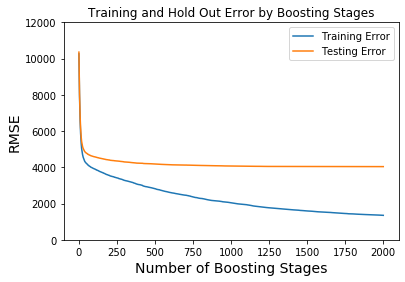

In [15]:
train_score = np.zeros(n_esti)
for i, y_pred in enumerate(gb.staged_predict(X_train)):
    train_score[i] = np.sqrt(mean_squared_error(y_train, y_pred))

test_score = np.zeros(n_esti)
for i, y_pred in enumerate(gb.staged_predict(X_test)):
    test_score[i] = np.sqrt(mean_squared_error(y_test, y_pred))
    
plt.plot(np.arange(n_esti) + 1, train_score,
        label="Training Error")
plt.plot(np.arange(n_esti) + 1, test_score,
        label="Testing Error")
plt.title("Training and Hold Out Error by Boosting Stages")
plt.xlabel('Number of Boosting Stages', fontsize=14)
plt.ylabel('RMSE', fontsize=14)
plt.legend(loc="upper right")
plt.ylim(0,12000)
plt.savefig('img/RMSE_2000_1.png', bbox_inches='tight')

In [119]:
plt.savefig('img/RMSE_2_1000.png', bbox_inches='tight')

<Figure size 432x288 with 0 Axes>

In [ ]:
n_estimators= [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000]
max_depth=[8, 10, 12]
learning_rate=[0.1, 0.2, 0,4]
random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
              'learning_rate': learning_rate}
pprint(random_grid)

In [ ]:
gb=GradientBoostingRegressor()
gb_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 10, cv = 3, verbose=1, random_state=42, n_jobs = -1)
gb_random.fit(X_train, y_train)

In [ ]:
# y=pd.concat([y_train, y_test], ignore_index=True)

In [ ]:
# y_train_pred=gb.predict(X_train)
# y_test_pred=gb.predict(X_test)
# y_base=np.ones(len(y_test))*y.median()

In [ ]:
# rmse_train=np.sqrt(gb.loss_(y_train, y_train_pred))
# rmse_test=np.sqrt(gb.loss_(y_test, y_test_pred))
# rmse_base=np.sqrt(gb.loss_(y_test, y_base))

In [ ]:
# print('RMSE of train : {:2.2f}'.format(rmse_train))
# print('RMSE of test : {:2.2f}'.format(rmse_test))
# print('RMSE of base : {:2.2f}'.format(rmse_base))
# print("Error reduction (RMSE of predict/RMSE of base) : {:2.2f}".format(rmse_test/rmse_base))

# Civic Case

In [ ]:
# index_civic=X_test[X_test.model_civic==True].index
# y_civic=y_test[index_civic]
# X_civic=X_test[X_test.model_civic==True]
# y_pred_civic=gb.predict(X_civic)

In [ ]:
# y_civic_median=np.ones(len(y_civic))*y_civic.median()

In [ ]:
# rmse_civic_pred=np.sqrt(gb.loss_(y_civic, y_pred_civic))

In [ ]:
# rmse_civic_base=np.sqrt(gb.loss_(y_civic, y_civic_median))

In [ ]:
# print('RMSE of test : {:2.2f}'.format(rmse_civic_pred))
# print('RMSE of base : {:2.2f}'.format(rmse_civic_base))
# print('Error reduction (RMSE of predict/RMSE of base) : {:2.2f}'.format(rmse_civic_pred/rmse_civic_base))

# Kelley Blue Book (KBB)

In [ ]:
# kbb_civic=np.zeros(X_test.shape[1])
# df_kbb_civic=pd.DataFrame(kbb_civic.reshape(1,-1), columns=X_test.columns)
# df_kbb_focus=pd.DataFrame(kbb_civic.reshape(1,-1), columns=X_test.columns)

In [ ]:
# df_kbb_civic['model_civic']=1
# df_kbb_civic['year']=(2020-2001)/40
# df_kbb_civic['mileage']=(161000-93453)/104729
# df_kbb_civic['paint_color_grey']=1
# df_kbb_civic['cylinders_4_cylinders']=1
# df_kbb_civic['fuel_gas']=1
# df_kbb_civic['type_sedan']=1
# df_kbb_civic['transmission_automatic']=1
# df_kbb_civic['drive_fwd']=1

In [ ]:
# print("'2001 Honda Civic EX Sedan'")
# print("Price posted in KBB by owner: $3,333")
# print("KBB typical listing price: $2,789")
# print("Suggested price by the model: ${:2.0f}".format(gb.predict(df_kbb_civic)[0]))

In [ ]:
# df_kbb_focus['model_focus']=1
# df_kbb_focus['year']=(2020-2016)/40
# df_kbb_focus['mileage']=(38532-93453)/104729
# df_kbb_focus['paint_color_white']=1
# df_kbb_focus['cylinders_4_cylinders']=1
# df_kbb_focus['fuel_gas']=1
# df_kbb_focus['transmission_automatic']=1
# df_kbb_focus['drive_fwd']=1

In [ ]:
# print("'2016 Ford Focus Hatchback'")
# print("Price posted in KBB by owner: $15,334")
# print("KBB typical listing price: $10,949")
# print("Suggested price by the model: ${:2.0f}".format(gb.predict(df_kbb_focus)[0]))

# Pickle

In [ ]:
# import pickle
# pickle.dump(gb, open("./model_v2.pkl","wb"))

# Tensorflow 2.0

In [ ]:
# from tensorflow import keras
# from tensorflow.keras import layers

# print(tf.__version__)

In [ ]:
# def build_model():
#     model = keras.Sequential([
#     layers.Dense(64, activation='relu', input_shape=[len(X_train.keys())]),
#     layers.Dense(64, activation='relu'),
#     layers.Dense(1)
#     ])

#     optimizer = tf.keras.optimizers.RMSprop(0.001)

#     model.compile(loss='mse',
#                 optimizer=optimizer,
#                 metrics=['mae', 'mse'])
#     return model

In [ ]:
# model = build_model()

# model.summary()

In [ ]:
# class PrintDot(keras.callbacks.Callback):
#     def on_epoch_end(self, epoch, logs):
#         if epoch % 100 == 0: print('')
#         print('.', end='')

# EPOCHS = 1000

# history = model.fit(
#   X_train, y_train,
#   epochs=EPOCHS, validation_split = 0.2, verbose=0,
#   callbacks=[PrintDot()])

In [ ]:
# hist = pd.DataFrame(history.history)
# hist['epoch'] = history.epoch
# hist.tail()

In [ ]:
# def plot_history(history):
#     hist = pd.DataFrame(history.history)
#     hist['epoch'] = history.epoch

#     plt.figure()
#     plt.xlabel('Epoch')
#     plt.ylabel('Mean Abs Error')
#     plt.plot(hist['epoch'], hist['mae'],
#            label='Train Error')
#     plt.plot(hist['epoch'], hist['val_mae'],
#            label = 'Val Error')
#     plt.ylim([0,4500])
#     plt.legend()

#     plt.figure()
#     plt.xlabel('Epoch')
#     plt.ylabel('Mean Square Error')
#     plt.plot(hist['epoch'], hist['mse'],
#            label='Train Error')
#     plt.plot(hist['epoch'], hist['val_mse'],
#            label = 'Val Error')
#     plt.ylim([0,50000000])
#     plt.legend()
#     plt.show()


# plot_history(history)

In [ ]:
# loss, mae, mse = model.evaluate(X_test, y_test, verbose=0)

# print("Testing set Mean Abs Error: {:5.2f}".format(mae))

In [ ]:
# test_predictions = model.predict(X_test).flatten()

# plt.scatter(y_test, test_predictions)
# plt.xlabel('True Values')
# plt.ylabel('Predictions')
# plt.axis('equal')
# plt.axis('square')
# plt.xlim([0,plt.xlim()[1]])
# plt.ylim([0,plt.ylim()[1]])
# #_ = plt.plot([-100, 100000], [-100, 100000])